In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import folium
import io
from PIL import Image
import os, time
# from selenium import webdriver
# import geocoder
from tqdm import tqdm
import geopandas as gpd
import pygeos

#### data processing choices

This number has to factor in very large errors in some g-s position data

In [413]:
join_dist=.0005
# join_dist=.001
# join_dist=.0015
# join_dist=.003

In [414]:
# choice = 'beach'
choice = 'transects'

In [415]:
merge = 'right'
# merge = 'left'

#### read gs data 

In [416]:
dataset = 'Data_Post2012_VerifiedOnshore'
#dataset = 'Data_VerifiedOnshore'

In [417]:
path='./data/CGRASP' 

In [418]:
cgrasp_dat = pd.read_csv(path+'/'+dataset+'.csv')
sand = cgrasp_dat[cgrasp_dat['d50']<2]

In [463]:
len(cgrasp_dat)

2113

In [419]:
gdf_sand = gpd.GeoDataFrame(
    sand, geometry=gpd.points_from_xy(sand.longitude, sand.latitude))

In [462]:
len(gdf_sand)

1552

#### read slope data 

In [420]:
slopes_t = pd.DataFrame(gpd.read_file('./data/beach_slopes/US_East_coast_slopes_by_transect.geojson'))
slopes_b = pd.DataFrame(gpd.read_file('./data/beach_slopes/US_East_coast_slopes_by_beach.geojson'))

In [421]:
slopes_t['points'] = slopes_t.apply(lambda x: [y for y in x['geometry'].coords], axis=1)
latlon = np.vstack([np.mean(s,axis=0) for s in slopes_t.points.values])

slopes_t.insert(2, "longitude", latlon[:,0], True)
slopes_t.insert(3, "latitude", latlon[:,1], True)

In [422]:
slopes_b['points'] = slopes_b.apply(lambda x: [y for y in x['geometry'].coords], axis=1)
latlon = np.vstack([np.mean(s,axis=0) for s in slopes_b.points.values])

slopes_b.insert(2, "longitude", latlon[:,0], True)
slopes_b.insert(3, "latitude", latlon[:,1], True)

#### plot grain size and slope data on map

In [423]:
map = folium.Map(
                location=[np.mean(sand['latitude']), np.mean(sand['longitude'])], 
                zoom_start=4, 
                control_scale=True,
                tiles='stamentoner',#tiles="Stamen Terrain", 
)

In [424]:
for counter, (lat,lon) in enumerate(zip(sand['latitude'],sand['longitude'])):
    folium.CircleMarker(location=[lat, lon],
                                radius = 3,
                                fill=True, # Set fill to True
                                color = 'red',
                                opacity=0.1,
                                fill_opacity=0.7).add_to(map)

In [425]:
for counter, (lat,lon) in enumerate(zip(slopes_t['latitude'],slopes_t['longitude'])):
    folium.CircleMarker(location=[lat, lon],
                                radius = 3,
                                fill=True, # Set fill to True
                                color = 'blue',
                                opacity=0.1,
                                fill_opacity=0.7).add_to(map)

In [426]:
for counter, (lat,lon) in enumerate(zip(slope_b['latitude'],slopes_b['longitude'])):
    folium.CircleMarker(location=[lat, lon],
                                radius = 3,
                                fill=True, # Set fill to True
                                color = 'magenta',
                                opacity=0.1,
                                fill_opacity=0.7).add_to(map)

In [427]:
map

In [379]:
# if choice=='beach':
#     slopes = slopes_b.copy()
# else:
#     slopes = slopes_t.copy()

In [428]:
if choice=='transects':
    gdf_slopes_b = gpd.GeoDataFrame(
    slopes_b, geometry=gpd.points_from_xy(slopes_b.longitude, slopes_b.latitude))

    gdf_slopes_t = gpd.GeoDataFrame(
    slopes_t, geometry=gpd.points_from_xy(slopes_t.longitude, slopes_t.latitude))    
    
    gdf_slopes = gpd.sjoin_nearest(gdf_slopes_b, gdf_slopes_t, how='right', distance_col='distance')
    
else:
    gdf_slopes = gpd.GeoDataFrame(
    slopes_b, geometry=gpd.points_from_xy(slopes_b.longitude, slopes_b.latitude))  
    
len(gdf_slopes)  

34067

In [429]:
gdf_slopes = gdf_slopes[['beach_slope_weighted_average',
       'longitude_left', 'latitude_left', 'width_ci_average',
       'quality_flag_left', 'beach_slope_average', 'beach_slope_median',
       'sl_points_average', 'mstr', 'prc_mstr_obs', 'min_tide_obs',
       'max_tide_obs','site_id', 'longitude_right', 'latitude_right', 'beach_slope',
       'lower_conf_bound', 'upper_conf_bound', 'width_ci','geometry',
       'quality_flag_right', 'sl_points', 'trend',
       'distance']].copy()

gdf_slopes.keys()

gdf_slopes = gpd.GeoDataFrame(gdf_slopes)

type(gdf_slopes)

geopandas.geodataframe.GeoDataFrame

In [430]:
gs_w_slope_data=gpd.sjoin_nearest(gdf_sand, gdf_slopes, how=merge)#, distance_col='distance')

len(gs_w_slope_data)

37759

In [431]:
ind = np.where(gs_w_slope_data['distance']<join_dist)[0]
tmp = gs_w_slope_data.iloc[ind]
len(tmp)

48

In [432]:
tmp = tmp[['latitude', 'longitude', 'd25', 'd30', 'd50', 'd65', 'd75', 'geometry', 
       'longitude_left', 'latitude_left',
       'width_ci_average', 'quality_flag_left', 'beach_slope_average',
       'beach_slope_median', 'sl_points_average', 'mstr', 'prc_mstr_obs',
       'min_tide_obs', 'max_tide_obs', 'site_id', 'longitude_right',
       'latitude_right', 'beach_slope', 'lower_conf_bound', 'upper_conf_bound',
       'width_ci', 'quality_flag_right', 'sl_points', 'trend', 'distance']].copy()

In [433]:
len(tmp.dropna())

40

In [434]:
tmp = tmp.dropna()

In [435]:
tmp.keys()

Index(['latitude', 'longitude', 'd25', 'd30', 'd50', 'd65', 'd75', 'geometry',
       'longitude_left', 'latitude_left', 'width_ci_average',
       'quality_flag_left', 'beach_slope_average', 'beach_slope_median',
       'sl_points_average', 'mstr', 'prc_mstr_obs', 'min_tide_obs',
       'max_tide_obs', 'site_id', 'longitude_right', 'latitude_right',
       'beach_slope', 'lower_conf_bound', 'upper_conf_bound', 'width_ci',
       'quality_flag_right', 'sl_points', 'trend', 'distance'],
      dtype='object')

In [436]:
try:
    map = folium.Map(
                    location=[np.mean(tmp['latitude_right']), np.mean(tmp['longitude_right'])], 
                    zoom_start=4, 
                    control_scale=True,
                    tiles='stamentoner',#tiles="Stamen Terrain", 
    )
    
    for counter, (lat,lon) in enumerate(zip(tmp['latitude_right'],tmp['longitude_right'])):
        folium.CircleMarker(location=[lat, lon],
                                    radius = 3,
                                    fill=True, # Set fill to True
                                    color = 'magenta',
                                    opacity=0.1,
                                    fill_opacity=0.7).add_to(map)

except:
    map = folium.Map(
                    location=[np.mean(tmp['latitude_left']), np.mean(tmp['longitude_left'])], 
                    zoom_start=4, 
                    control_scale=True,
                    tiles='stamentoner',#tiles="Stamen Terrain", 
    )
    
    for counter, (lat,lon) in enumerate(zip(tmp['latitude_left'],tmp['longitude_left'])):
        folium.CircleMarker(location=[lat, lon],
                                    radius = 3,
                                    fill=True, # Set fill to True
                                    color = 'magenta',
                                    opacity=0.1,
                                    fill_opacity=0.7).add_to(map)
    
map

Text(0.25, 0.16, '$R^2$=0.55')

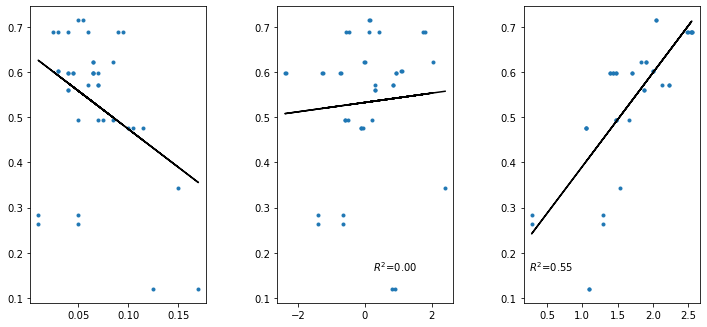

In [437]:
plt.figure(figsize=(12,12))
plt.subplots_adjust(wspace=0.4)
plt.subplot(231)
plt.plot(tmp['beach_slope'],tmp['d50'],'.')

coef = np.polyfit(tmp['beach_slope'],tmp['d50'],1)
poly1d_fn = np.poly1d(coef) 
plt.plot(tmp['beach_slope'], poly1d_fn(tmp['beach_slope']), '-k')

r2 = np.min(np.corrcoef(tmp['d50'], tmp['beach_slope']))**2
plt.text(.25,.16,r'$R^2$='+str(r2)[:4])

plt.subplot(232)
plt.plot(tmp['trend'],tmp['d50'],'.')

coef = np.polyfit(tmp['trend'],tmp['d50'],1)
poly1d_fn = np.poly1d(coef) 
plt.plot(tmp['trend'], poly1d_fn(tmp['trend']), '-k')

r2 = np.min(np.corrcoef(tmp['d50'], tmp['trend']))**2
plt.text(.25,.16,r'$R^2$='+str(r2)[:4])

plt.subplot(233)
plt.plot(tmp['mstr'],tmp['d50'],'.')

coef = np.polyfit(tmp['mstr'],tmp['d50'],1)
poly1d_fn = np.poly1d(coef) 
plt.plot(tmp['mstr'], poly1d_fn(tmp['mstr']), '-k')

r2 = np.min(np.corrcoef(tmp['d50'], tmp['mstr']))**2
plt.text(.25,.16,r'$R^2$='+str(r2)[:4])

395

#### merge waves

In [438]:
dir_df=pd.read_csv('./data/WaveData/Dir.csv')
hsmax_df=pd.read_csv('./data/WaveData/HsMax.csv')
hsmean_df=pd.read_csv('./data/WaveData/HsMean.csv')
tp_df=pd.read_csv('./data/WaveData/Tp.csv')

In [439]:
dir_df = dir_df.rename(columns={"lat": "latitude", "lon": "longitude"})
hsmax_df = hsmax_df.rename(columns={"lat": "latitude", "lon": "longitude"})
hsmean_df = hsmean_df.rename(columns={"lat": "latitude", "lon": "longitude"})
tp_df = tp_df.rename(columns={"lat": "latitude", "lon": "longitude"})


In [440]:
#rename wave variable dataframe columns to yyyy-mm-dd format
i=0
for i in tqdm(range(0,len(dir_df.columns)-2)):
    focus_col=dir_df.columns[2+i]
    timestamps = pd.to_datetime(int(focus_col)-719529, unit='D').strftime("%Y-%m-%d")
    stamp=str(timestamps)
    dir_df=dir_df.rename(columns={focus_col:stamp})
    i=i+1
    
print('dir done')
#rename wave variable dataframe columns to yyyy-mm-dd format
i=0
for i in tqdm(range(0,len(hsmax_df.columns)-2)):
    focus_col=hsmax_df.columns[2+i]
    timestamps = pd.to_datetime(int(focus_col)-719529, unit='D').strftime("%Y-%m-%d")
    stamp=str(timestamps)
    hsmax_df=hsmax_df.rename(columns={focus_col:stamp})
    i=i+1
    
print('hsmax done')

i=0
for i in tqdm(range(0,len(hsmean_df.columns)-2)):
    focus_col=hsmean_df.columns[2+i]
    timestamps = pd.to_datetime(int(focus_col)-719529, unit='D').strftime("%Y-%m-%d")
    stamp=str(timestamps)
    hsmean_df=hsmean_df.rename(columns={focus_col:stamp})
    i=i+1
    
print('hsmean done')

i=0
for i in tqdm(range(0,len(tp_df.columns)-2)):
    focus_col=tp_df.columns[2+i]
    timestamps = pd.to_datetime(int(focus_col)-719529, unit='D').strftime("%Y-%m-%d")
    stamp=str(timestamps)
    tp_df=tp_df.rename(columns={focus_col:stamp})
    i=i+1
    
print('tp done')


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10713/10713 [00:38<00:00, 281.71it/s]


dir done


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10713/10713 [00:38<00:00, 278.89it/s]


hsmax done


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10713/10713 [00:37<00:00, 282.25it/s]


hsmean done


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10713/10713 [00:38<00:00, 279.94it/s]

tp done


In [441]:
df=tmp.copy()
df=pd.DataFrame(df)

# df

,latitude,longitude,d25,d30,d50,d65,d75,geometry,longitude_left,latitude_left,...,longitude_right,latitude_right,beach_slope,lower_conf_bound,upper_conf_bound,width_ci,quality_flag_right,sl_points,trend,distance
1892,26.29459,-80.07762,0.379159,0.398646,0.476595,0.539638,0.617061,POINT (-80.09592 26.17623),-80.095914,26.176687,...,-80.095916,26.176234,0.105,0.0836,0.1407,0.0571,Low,406.0,-0.057957,0.000453
1893,26.29459,-80.07762,0.379159,0.398646,0.476595,0.539638,0.617061,POINT (-80.09581 26.17668),-80.095914,26.176687,...,-80.095815,26.176678,0.115,0.0913,0.1598,0.0685,Low,394.0,-0.129715,0.000100
1894,26.29459,-80.07762,0.379159,0.398646,0.476595,0.539638,0.617061,POINT (-80.09574 26.17712),-80.095914,26.176687,...,-80.095741,26.177124,0.100,0.0831,0.1327,0.0496,Medium,379.0,-0.108099,0.000470
2479,26.44128,-80.06045,0.094779,0.099642,0.119091,0.134839,0.154181,POINT (-80.05920 26.44092),-80.059000,26.441141,...,-80.059201,26.440924,0.170,0.0859,0.2000,0.1141,Low,386.0,0.889053,0.000296
2480,26.44128,-80.06045,0.094779,0.099642,0.119091,0.134839,0.154181,POINT (-80.05916 26.44137),-80.059000,26.441141,...,-80.059162,26.441374,0.125,0.0898,0.2000,0.1102,Low,380.0,0.819785,0.000284
6544,29.01298,-80.88033,0.394699,0.414529,0.493848,0.559015,0.638968,POINT (-80.59182 28.19436),-80.592100,28.194769,...,-80.591824,28.194361,0.075,0.0659,0.0870,0.0211,High,864.0,-0.520437,0.000493
6545,29.01298,-80.88033,0.394699,0.414529,0.493848,0.559015,0.638968,POINT (-80.59191 28.19481),-80.592100,28.194769,...,-80.591911,28.194806,0.070,0.0638,0.0810,0.0172,High,868.0,-0.589974,0.000193
6546,29.01298,-80.88033,0.394699,0.414529,0.493848,0.559015,0.638968,POINT (-80.59200 28.19525),-80.592100,28.194769,...,-80.592004,28.195250,0.085,0.0742,0.0980,0.0238,High,887.0,-0.585436,0.000490
8872,29.01298,-80.88033,0.394699,0.414529,0.493848,0.559015,0.638968,POINT (-80.94907 29.12173),-80.949399,29.121464,...,-80.949074,29.121728,0.050,0.0444,0.0587,0.0143,High,461.0,0.218686,0.000419
10394,29.85410,-81.26470,0.444864,0.467721,0.559148,0.633111,0.723943,POINT (-81.24703 29.76180),-81.247225,29.761817,...,-81.247035,29.761795,0.040,0.0387,0.0450,0.0063,High,462.0,0.297904,0.000192


In [442]:
df= gpd.GeoDataFrame(
    df, geometry=gpd.points_from_xy(df.longitude, df.latitude))

In [443]:
# df.keys()

Index(['latitude', 'longitude', 'd25', 'd30', 'd50', 'd65', 'd75', 'geometry',
       'longitude_left', 'latitude_left', 'width_ci_average',
       'quality_flag_left', 'beach_slope_average', 'beach_slope_median',
       'sl_points_average', 'mstr', 'prc_mstr_obs', 'min_tide_obs',
       'max_tide_obs', 'site_id', 'longitude_right', 'latitude_right',
       'beach_slope', 'lower_conf_bound', 'upper_conf_bound', 'width_ci',
       'quality_flag_right', 'sl_points', 'trend', 'distance'],
      dtype='object')

In [445]:
dir_gdf= gpd.GeoDataFrame(
    dir_df, geometry=gpd.points_from_xy(dir_df.longitude, dir_df.latitude))

# dirmerge=gpd.sjoin_nearest(df, dir_gdf, how='left', distance_col='distance')
dirmerge=gpd.sjoin_nearest(df, dir_gdf, how=merge)#, distance_col='distance')

filter_col = [col for col in dirmerge if col.startswith('20')]
dirmerge.insert(0, "dir", dirmerge[filter_col].mean(axis=1).values, True)

len(dirmerge)

/home/marda/anaconda3/envs/cgrasp/lib/python3.10/site-packages/geopandas/geodataframe.py:1378: FutureWarning: Passing 'suffixes' which cause duplicate columns {'latitude_left', 'longitude_left'} in the result is deprecated and will raise a MergeError in a future version.
  result = DataFrame.merge(self, *args, **kwargs)


939

In [446]:

hsmean_gdf= gpd.GeoDataFrame(
    hsmean_df, geometry=gpd.points_from_xy(hsmean_df.longitude, hsmean_df.latitude))

hsmeanmerge=gpd.sjoin_nearest(df, hsmean_gdf, how=merge)#, distance_col='distance')

filter_col = [col for col in hsmeanmerge if col.startswith('20')]
hsmeanmerge.insert(0, "hs_mean", hsmeanmerge[filter_col].mean(axis=1).values, True)


hsmax_gdf= gpd.GeoDataFrame(
    hsmax_df, geometry=gpd.points_from_xy(hsmax_df.longitude, hsmax_df.latitude))

hsmaxmerge=gpd.sjoin_nearest(df, hsmax_gdf, how=merge)#, distance_col='distance')

filter_col = [col for col in hsmaxmerge if col.startswith('20')]
hsmaxmerge.insert(0, "hs_max", hsmaxmerge[filter_col].mean(axis=1).values, True)


tp_gdf= gpd.GeoDataFrame(
    tp_df, geometry=gpd.points_from_xy(tp_df.longitude, tp_df.latitude))

tpmerge=gpd.sjoin_nearest(df, tp_gdf, how=merge)#, distance_col='distance')

filter_col = [col for col in tpmerge if col.startswith('20')]
tpmerge.insert(0, "tp", tpmerge[filter_col].mean(axis=1).values, True)


/home/marda/anaconda3/envs/cgrasp/lib/python3.10/site-packages/geopandas/geodataframe.py:1378: FutureWarning: Passing 'suffixes' which cause duplicate columns {'latitude_left', 'longitude_left'} in the result is deprecated and will raise a MergeError in a future version.
  result = DataFrame.merge(self, *args, **kwargs)
/home/marda/anaconda3/envs/cgrasp/lib/python3.10/site-packages/geopandas/geodataframe.py:1378: FutureWarning: Passing 'suffixes' which cause duplicate columns {'latitude_left', 'longitude_left'} in the result is deprecated and will raise a MergeError in a future version.
  result = DataFrame.merge(self, *args, **kwargs)
/home/marda/anaconda3/envs/cgrasp/lib/python3.10/site-packages/geopandas/geodataframe.py:1378: FutureWarning: Passing 'suffixes' which cause duplicate columns {'latitude_left', 'longitude_left'} in the result is deprecated and will raise a MergeError in a future version.
  result = DataFrame.merge(self, *args, **kwargs)


In [447]:
tpmerge.keys()[:40]

Index(['tp', 'index_left', 'latitude_left', 'longitude_left', 'd25', 'd30',
       'd50', 'd65', 'd75', 'longitude_left', 'latitude_left',
       'width_ci_average', 'quality_flag_left', 'beach_slope_average',
       'beach_slope_median', 'sl_points_average', 'mstr', 'prc_mstr_obs',
       'min_tide_obs', 'max_tide_obs', 'site_id', 'longitude_right',
       'latitude_right', 'beach_slope', 'lower_conf_bound', 'upper_conf_bound',
       'width_ci', 'quality_flag_right', 'sl_points', 'trend', 'distance',
       'latitude_right', 'longitude_right', '1990-01-01', '1990-01-02',
       '1990-01-03', '1990-01-04', '1990-01-05', '1990-01-06', '1990-01-07'],
      dtype='object')

In [448]:
out_df = tpmerge[['tp', 'latitude_left', 'longitude_left', 'd25', 'd30',
       'd50', 'd65', 'd75', 'width_ci_average', 'quality_flag_left', 'beach_slope_average',
       'beach_slope_median', 'sl_points_average', 'mstr', 'prc_mstr_obs',
       'min_tide_obs', 'max_tide_obs', 'site_id', 'beach_slope', 'lower_conf_bound', 'upper_conf_bound',
       'width_ci', 'quality_flag_right', 'sl_points', 'trend', 'distance',
       'latitude_right', 'longitude_right']].copy()

In [449]:
out_df.insert(0, "dir", dirmerge.iloc[:, [0]].values.squeeze(), True)
out_df.insert(0, "hs_mean", hsmeanmerge.iloc[:, [0]].values.squeeze(), True)
out_df.insert(0, "hs_max", hsmaxmerge.iloc[:, [0]].values.squeeze(), True)
out_df = out_df.dropna()

out_df = out_df.drop_duplicates()

In [450]:
ind = np.where(out_df['distance']<join_dist)[0]
tmp = out_df.iloc[ind]
len(tmp)

939

In [451]:
tmp['d50']

0      0.476595
0      0.476595
0      0.476595
1      0.476595
1      0.476595
         ...   
245    0.344253
246    0.344253
247    0.344253
248    0.344253
249    0.344253
Name: d50, Length: 939, dtype: float64

Text(0.25, 0.16, '$R^2$=0.25')

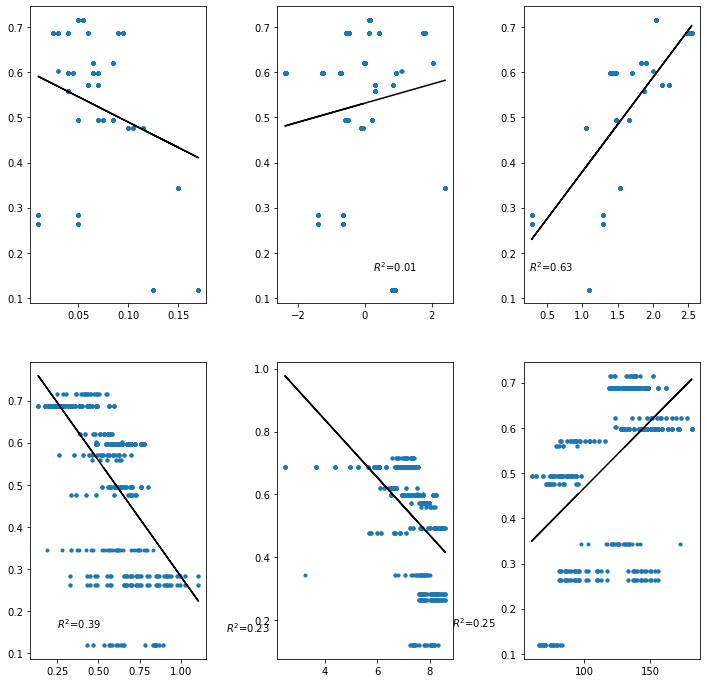

In [452]:
plt.figure(figsize=(12,12))
plt.subplots_adjust(wspace=0.4)
plt.subplot(231)
plt.plot(tmp['beach_slope'],tmp['d50'],'.')

coef = np.polyfit(tmp['beach_slope'],tmp['d50'],1)
poly1d_fn = np.poly1d(coef) 
plt.plot(tmp['beach_slope'], poly1d_fn(tmp['beach_slope']), '-k')

r2 = np.min(np.corrcoef(tmp['d50'], tmp['beach_slope']))**2
plt.text(.25,.16,r'$R^2$='+str(r2)[:4])

plt.subplot(232)
plt.plot(tmp['trend'],tmp['d50'],'.')

coef = np.polyfit(tmp['trend'],tmp['d50'],1)
poly1d_fn = np.poly1d(coef) 
plt.plot(tmp['trend'], poly1d_fn(tmp['trend']), '-k')

r2 = np.min(np.corrcoef(tmp['d50'], tmp['trend']))**2
plt.text(.25,.16,r'$R^2$='+str(r2)[:4])

plt.subplot(233)
plt.plot(tmp['mstr'],tmp['d50'],'.')

coef = np.polyfit(tmp['mstr'],tmp['d50'],1)
poly1d_fn = np.poly1d(coef) 
plt.plot(tmp['mstr'], poly1d_fn(tmp['mstr']), '-k')

r2 = np.min(np.corrcoef(tmp['d50'], tmp['mstr']))**2
plt.text(.25,.16,r'$R^2$='+str(r2)[:4])


plt.subplot(234)
plt.plot(tmp['hs_mean'],tmp['d50'],'.')

coef = np.polyfit(tmp['hs_mean'],tmp['d50'],1)
poly1d_fn = np.poly1d(coef) 
plt.plot(tmp['hs_mean'], poly1d_fn(tmp['hs_mean']), '-k')

r2 = np.min(np.corrcoef(tmp['d50'], tmp['hs_mean']))**2
plt.text(.25,.16,r'$R^2$='+str(r2)[:4])

plt.subplot(235)
plt.plot(tmp['tp'],tmp['d50'],'.')

coef = np.polyfit(tmp['tp'],tmp['d50'],1)
poly1d_fn = np.poly1d(coef) 
plt.plot(tmp['tp'], poly1d_fn(tmp['tp']), '-k')

r2 = np.min(np.corrcoef(tmp['d50'], tmp['tp']))**2
plt.text(.25,.16,r'$R^2$='+str(r2)[:4])

plt.subplot(236)
plt.plot(tmp['dir'],tmp['d50'],'.')

coef = np.polyfit(tmp['dir'],tmp['d50'],1)
poly1d_fn = np.poly1d(coef) 
plt.plot(tmp['dir'], poly1d_fn(tmp['dir']), '-k')

r2 = np.min(np.corrcoef(tmp['d50'], tmp['dir']))**2
plt.text(.25,.16,r'$R^2$='+str(r2)[:4])

In [453]:
# tmp.keys()

In [454]:
join_dist

0.0005

In [455]:
ind = np.where(tmp['distance']<join_dist)[0]
tmp = tmp.iloc[ind]
len(tmp)

939

In [456]:
tmp['latitude']=np.mean(tmp['latitude_right'],axis=1)
tmp['longitude']=np.mean(tmp['longitude_right'],axis=1)
tmp=tmp.drop(columns=['latitude_right','longitude_right'])

In [457]:
# tmp['latitude']=np.mean(tmp['latitude_right'],axis=1)
# tmp['longitude']=np.mean(tmp['longitude_right'],axis=1)
# tmp=tmp.drop(columns=['latitude_right','longitude_right'])

In [458]:
tmp.keys()

Index(['hs_max', 'hs_mean', 'dir', 'tp', 'latitude_left', 'latitude_left',
       'longitude_left', 'longitude_left', 'd25', 'd30', 'd50', 'd65', 'd75',
       'width_ci_average', 'quality_flag_left', 'beach_slope_average',
       'beach_slope_median', 'sl_points_average', 'mstr', 'prc_mstr_obs',
       'min_tide_obs', 'max_tide_obs', 'site_id', 'beach_slope',
       'lower_conf_bound', 'upper_conf_bound', 'width_ci',
       'quality_flag_right', 'sl_points', 'trend', 'distance', 'latitude',
       'longitude'],
      dtype='object')

In [459]:
# try:
map = folium.Map(
                location=[np.mean(tmp['latitude']), np.mean(tmp['longitude'])], 
                zoom_start=4, 
                control_scale=True,
                tiles='stamentoner',#tiles="Stamen Terrain", 
)

for counter, (lat,lon) in enumerate(zip(tmp['latitude'],tmp['longitude'])):
    folium.CircleMarker(location=[lat, lon],
                                radius = 3,
                                fill=True, # Set fill to True
                                color = 'magenta',
                                opacity=0.1,
                                fill_opacity=0.7).add_to(map)
    
map

In [460]:
tmp.to_csv('ML_slope_wave_atlantic_'+dataset+'_'+str(join_dist)+'_'+merge+'_'+choice+'.csv')